In [29]:
import json
import numpy as np
from shapely.geometry import shape, box, GeometryCollection, Polygon, Point
from shapely.affinity import scale
from packer import CirclePackerBee, IrregularPacker

In [13]:
containers = [
    box(-0.5, -0.5, 1, 0.5),
    box(-2, -2, 4, 2),
    box(-5, -5, 10, 5),
]

In [16]:
radius = 0.125

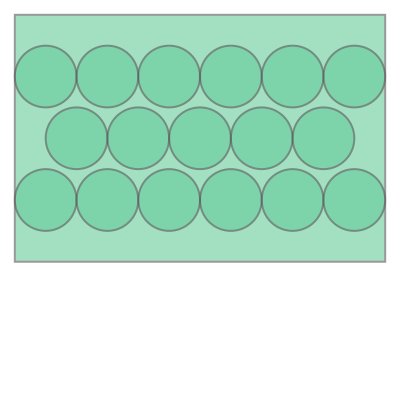

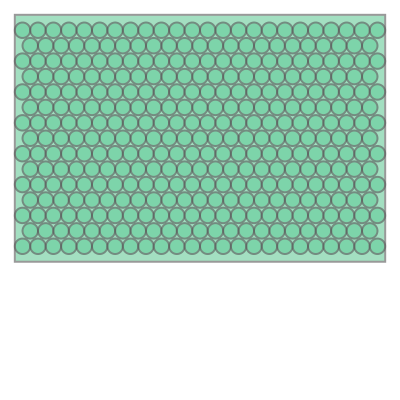

In [17]:
for container in containers:
    packer = CirclePackerBee(container, radius=radius)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

In [18]:
with open('../shapes/random_polygons.json', 'r') as f:
    shapes = json.load(f)
    shapes = [shape(s) for s in shapes]

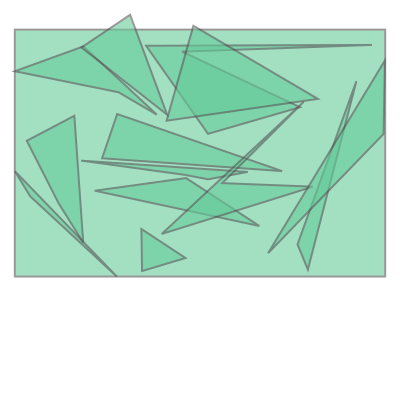

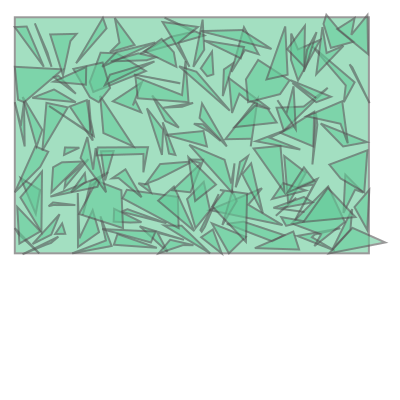

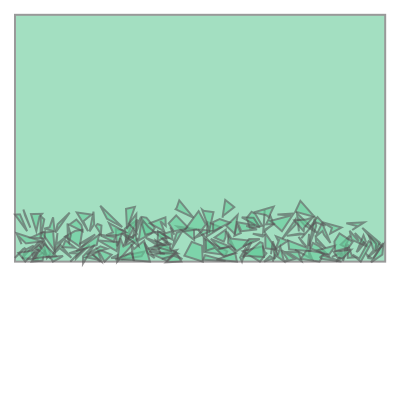

In [19]:
for container in containers:
    packer = IrregularPacker(container, shapes)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

In [22]:
def generate_random_shape(min_value, max_value):
    while True:
        poly = Polygon(np.random.uniform(min_value, max_value, (np.random.randint(3, 6), 2)))
        if poly.is_valid:
            return poly

In [27]:
shapes_large = [generate_random_shape(0, 1) for _ in range(1000)]

In [121]:
with open('../shapes/random_polygons_large.json', 'w') as file:
    json.dump([{"type": "Polygon", "coordinates": [list(shape.exterior.coords)]} for shape in shapes_large], file)

In [122]:
with open('../shapes/random_polygons_large.json', 'r') as f:
    shapes_large = json.load(f)
    shapes_large = [shape(s) for s in shapes_large]

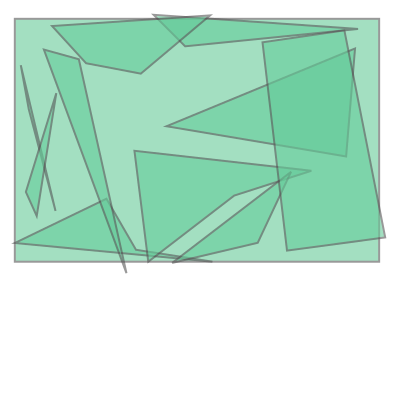

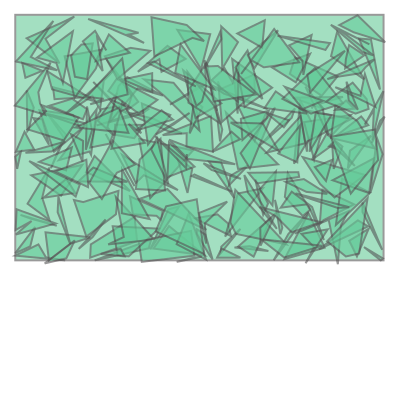

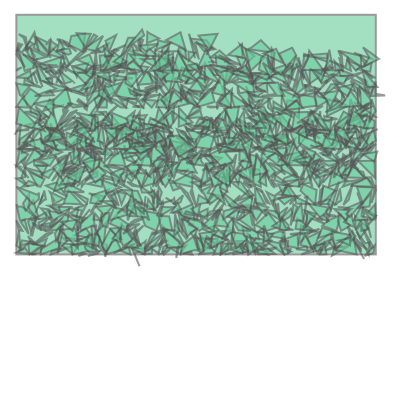

In [28]:
for container in containers:
    packer = IrregularPacker(container, shapes_large)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

In [58]:
hole_containers = [
    containers[0].symmetric_difference(Point((0.25, 0)).buffer(0.3)),
    containers[1].symmetric_difference(Point((1, 0)).buffer(1.2)),
    containers[2].symmetric_difference(Point((4, 0)).buffer(4.8)),
]

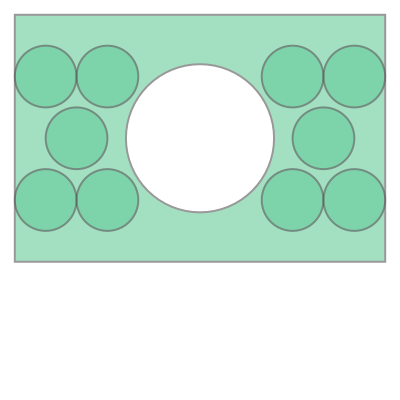

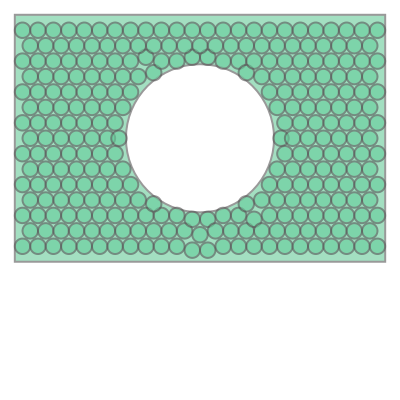

In [59]:
for container in hole_containers:
    packer = CirclePackerBee(container, radius=radius)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

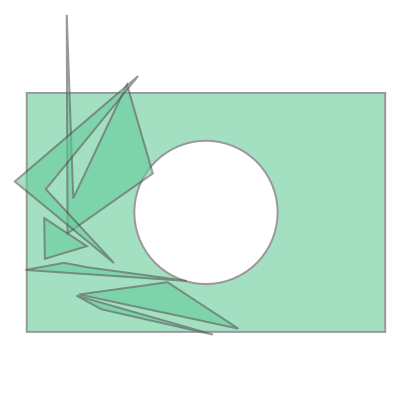

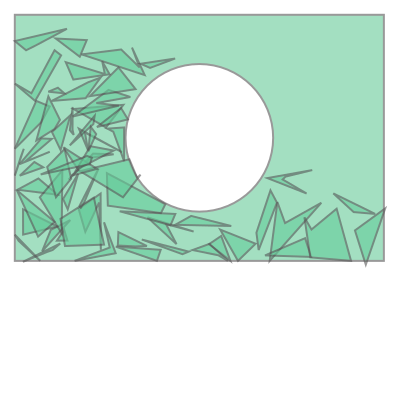

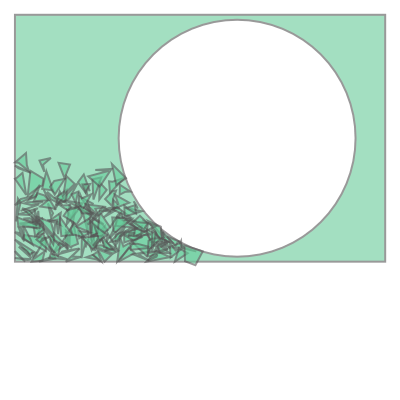

In [61]:
for container in hole_containers:
    packer = IrregularPacker(container, shapes)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

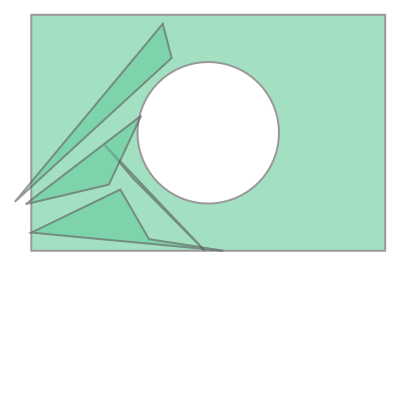

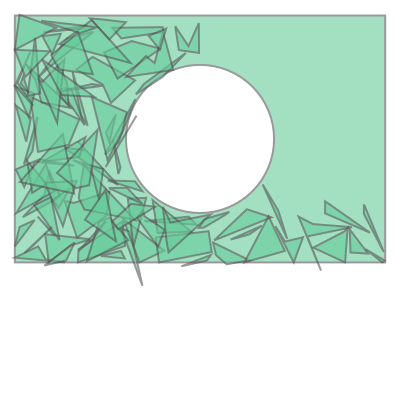

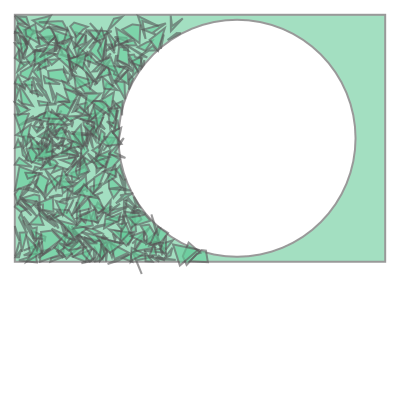

In [62]:
for container in hole_containers:
    packer = IrregularPacker(container, shapes_large)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

In [64]:
polygon = Polygon(((-0.5, -0.5), (0.2, 0.2), (0.8, 0.2), (0.6, 0.6), (1, 0.6), (1, 0.7), (0, 0.7), (-0.5, 0.5), (-0.2, 0)))

In [65]:
irregular_containers = [
    polygon,
    scale(polygon, 4, 4),
    scale(polygon, 16, 16),
]

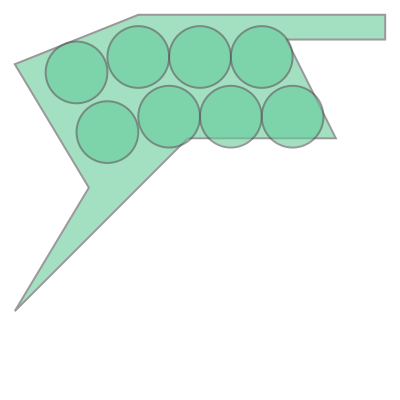

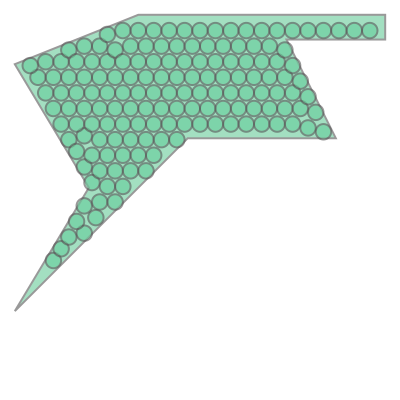

In [66]:
for container in irregular_containers:
    packer = CirclePackerBee(container, radius=radius)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

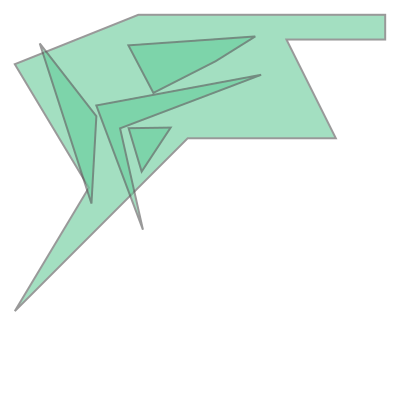

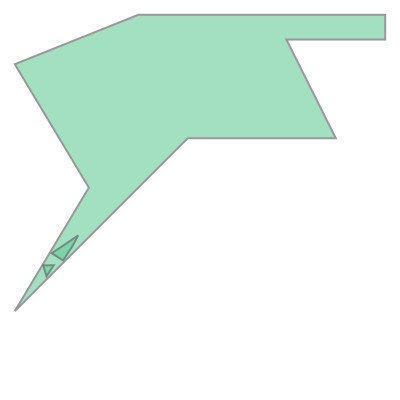

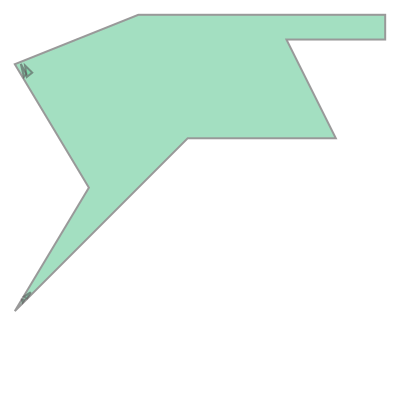

In [67]:
for container in irregular_containers:
    packer = IrregularPacker(container, shapes)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

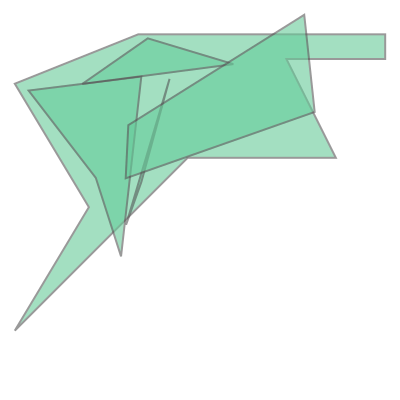

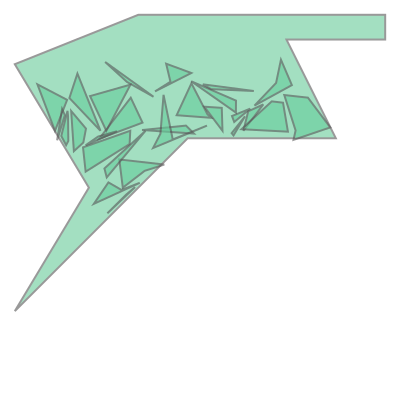

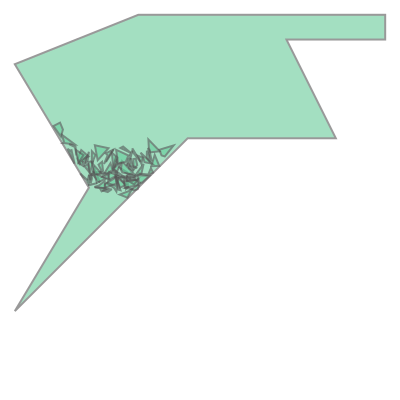

In [68]:
for container in irregular_containers:
    packer = IrregularPacker(container, shapes_large)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

In [98]:
irregular_hole_containers = [
    irregular_containers[0].symmetric_difference(Point((0.25, 0.45)).buffer(0.2)),
    irregular_containers[1].symmetric_difference(Point((1, 1.5)).buffer(0.6)),
    irregular_containers[2].symmetric_difference(Point((-3, 5)).buffer(3)),
]

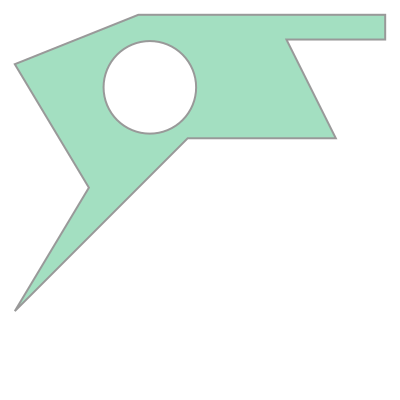

In [99]:
irregular_hole_containers[2]

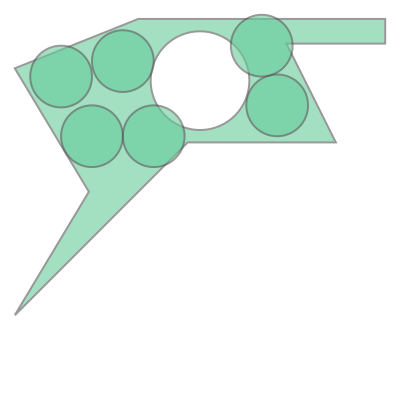

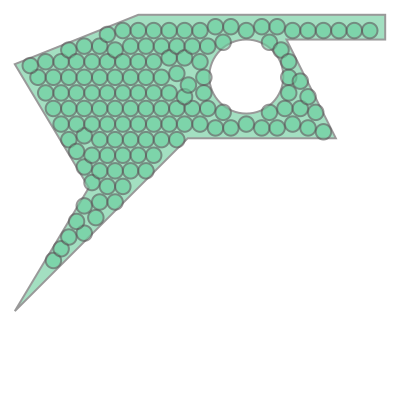

In [100]:
for container in irregular_hole_containers:
    packer = CirclePackerBee(container, radius=radius)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

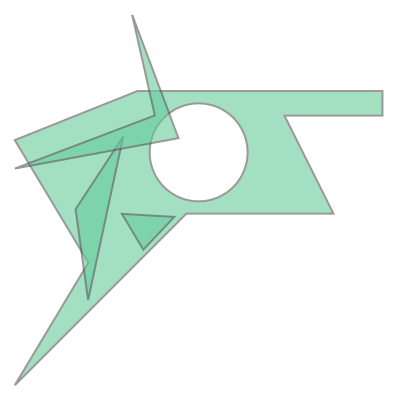

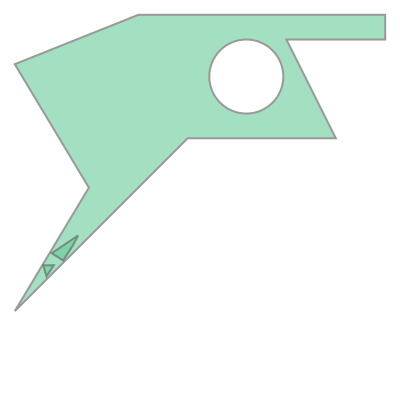

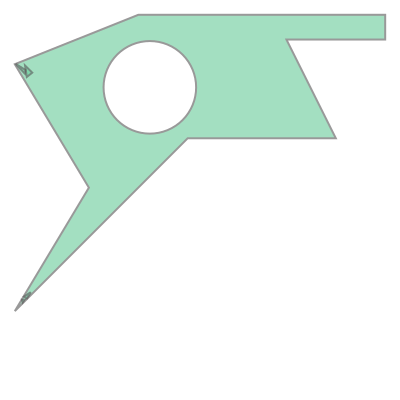

In [101]:
for container in irregular_hole_containers:
    packer = IrregularPacker(container, shapes)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))

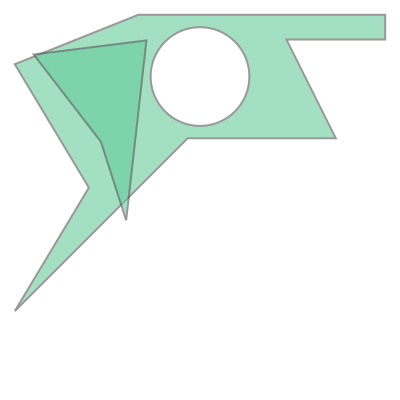

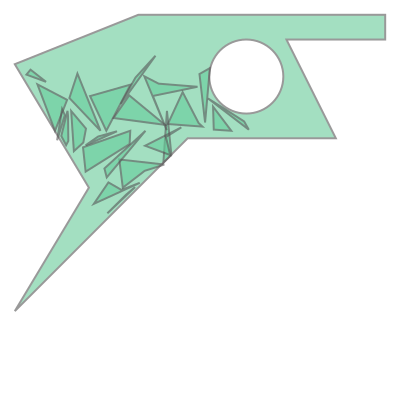

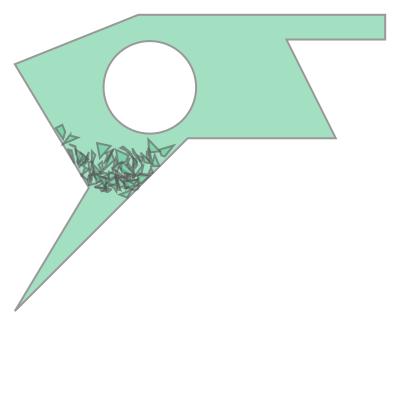

In [102]:
for container in irregular_hole_containers:
    packer = IrregularPacker(container, shapes_large)
    df = packer.pack()
    display(GeometryCollection([container, *df['item']]))